# Capstone Project

## Import Libraries

In [1]:
# Import Pandas and Numpy to provide DataFrame support
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import numpy as np

In [2]:
# Use the inline backend to generate the plots within the browser
%matplotlib inline 

import matplotlib as mpl
import matplotlib.pyplot as plt

import seaborn as sns
sns.set_style("darkgrid")

font = {'size'   : 12}
mpl.rc('font', **font)

In [3]:
# Use Folium to display the Maps for Visualisation
!pip -q install folium
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
from folium import plugins

# Module to convert an address into latitude and longitude values
from geopy.geocoders import Nominatim

In [4]:

 
search_params = {
    'client_id': 'V0J1F4DNOTEQXEN25MDO1OF0DQLYIUBL5GL2UJH2FQXXLSI2',
    'client_secret': 'LHDHYGYJIYNBPF4FJP1RWR4AEM0C504FMFVZGRIXLY1CJDIX',
    'intent': 'browse',
    'limit': 50,
    'v': 20180604
}

In [5]:
# All the SciKit Learn Libraries Required
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import BernoulliNB
from sklearn.ensemble import RandomForestClassifier
from sklearn import metrics
from sklearn.model_selection import KFold, cross_val_score

def cross_validate(model, n_splits = 10):
    
    k_fold = KFold(n_splits = n_splits)
    scores = [model.fit(X[train], y[train]).score(X[test], y[test]) for train, test in k_fold.split(X)]
    
    scores = np.percentile(scores, [40, 50, 60])
    return scores

## Import and process the Chicago Crime DataSet

This dataset reflects reported incidents of crime (with the exception of murders where data exists for each victim) that occurred in the City of Chicago in the last year, minus the most recent seven days. Data is extracted from the Chicago Police Department's CLEAR (Citizen Law Enforcement Analysis and Reporting) system. 

In [6]:
# These are the columns that we want to keep.
# Columns not listed here won't be imported, speeding things up.
crime_keep_columns = ['CASE#',
                      'DATE  OF OCCURRENCE',
                      'BLOCK', 
                      ' PRIMARY DESCRIPTION',
                      'WARD',
                      'LATITUDE',
                      'LONGITUDE']

# Download csv
!wget -O crimes.csv https://data.cityofchicago.org/api/views/x2n5-8w5q/rows.csv?accessType=DOWNLOAD

# Read from local
df = pd.read_csv('crimes.csv',
                 usecols=crime_keep_columns)

--2020-06-09 09:34:31--  https://data.cityofchicago.org/api/views/x2n5-8w5q/rows.csv?accessType=DOWNLOAD
Resolving data.cityofchicago.org (data.cityofchicago.org)... 52.206.68.26, 52.206.140.199, 52.206.140.205
Connecting to data.cityofchicago.org (data.cityofchicago.org)|52.206.68.26|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/csv]
Saving to: ‘crimes.csv’

    [         <=>                           ] 44,351,230  3.26MB/s   in 13s    

2020-06-09 09:34:45 (3.21 MB/s) - ‘crimes.csv’ saved [44351230]



In [7]:
df.shape

(237631, 7)

In [8]:
df.head()

,CASE#,DATE OF OCCURRENCE,BLOCK,PRIMARY DESCRIPTION,WARD,LATITUDE,LONGITUDE
0,JD141525,02/05/2020 02:54:00 PM,030XX N HALSTED ST,THEFT,44.0,NaN,NaN
1,JD205528,04/09/2020 02:00:00 PM,029XX S ARCHER AVE,CRIMINAL DAMAGE,11.0,41.841609,-87.658034
2,JD177980,03/08/2020 02:15:00 AM,064XX S DR MARTIN LUTHER KING JR DR,CRIMINAL TRESPASS,20.0,41.777671,-87.615561
3,JC497784,11/03/2019 11:40:00 AM,032XX N CLARK ST,THEFT,44.0,NaN,NaN
4,JD195928,03/21/2020 10:05:00 PM,019XX E 73RD PL,DECEPTIVE PRACTICE,7.0,NaN,NaN


In [9]:
df.tail()

,CASE#,DATE OF OCCURRENCE,BLOCK,PRIMARY DESCRIPTION,WARD,LATITUDE,LONGITUDE
237626,JC356571,07/19/2019 09:00:00 PM,031XX W HARRISON ST,OTHER OFFENSE,24.0,41.873699,-87.704705
237627,JC318635,06/23/2019 04:40:00 PM,005XX N CENTRAL AVE,BATTERY,37.0,41.889742,-87.765198
237628,JC405144,08/23/2019 11:00:00 PM,019XX W SCHILLER ST,THEFT,1.0,41.907177,-87.675381
237629,JC379670,08/05/2019 12:30:00 PM,074XX S HARVARD AVE,BATTERY,6.0,41.759037,-87.633299
237630,JC316226,06/18/2019 04:00:00 PM,034XX W 71ST PL,BURGLARY,17.0,41.763391,-87.708287


In [10]:
# Strip leading & trailing whitespace
df.columns = df.columns.str.strip()

# Replace multiple spaces with a single space
df.columns = df.columns.str.replace('\s{2,}', ' ')

# Replace # with blank
df.columns = df.columns.str.replace('#', '')

# Replace spaces with _
df.columns = df.columns.str.replace(' ', '_')

# Convert to lowercase
df.columns = df.columns.str.lower()

# Move September 2017 dates to September 2018
df.date_of_occurrence.replace(to_replace="(09/\\d+)/2017", value=r"\1/2018", regex=True, inplace=True)

In [11]:
df.dtypes

case                    object
date_of_occurrence      object
block                   object
primary_description     object
ward                   float64
latitude               float64
longitude              float64
dtype: object

In [12]:
df['date_of_occurrence'] =  pd.to_datetime(df['date_of_occurrence'], format='%m/%d/%Y %I:%M:%S %p')



Add new columns for the hour, day, month and year of the crime:
<ul>
   <li> Hour </li>
   <li> Day Name </li>
   <li> Day of week (Tuesday is the first day)</li>
   <li> Month Name </li>
   <li> Month Number </li>
   <li> Year </li>
   <li> Year and Month </li>
<ul>



In [13]:
df['hour'] = df['date_of_occurrence'].dt.hour
df['day_name'] = df['date_of_occurrence'].dt.day_name()
df['day'] = df['date_of_occurrence'].dt.dayofweek + 1
df['month_name'] = df['date_of_occurrence'].dt.month_name()
df['month'] = df['date_of_occurrence'].dt.month
df['year'] = df['date_of_occurrence'].dt.year
df['year_month'] = df['date_of_occurrence'].dt.to_period('M')

Split Block into zip_code and street

In [14]:
df['zip'] = df.block.str.split(' ').str[0]
df['street'] = df.block.str.split(' ').str[1:].apply(', '.join)

In [15]:
df.isna().sum()

case                      0
date_of_occurrence        0
block                     0
primary_description       0
ward                     12
latitude               1400
longitude              1400
hour                      0
day_name                  0
day                       0
month_name                0
month                     0
year                      0
year_month                0
zip                       0
street                    0
dtype: int64

In [16]:
df.dropna(inplace=True)
df.reindex()
df.head()

,case,date_of_occurrence,block,primary_description,ward,latitude,longitude,hour,day_name,day,month_name,month,year,year_month,zip,street
1,JD205528,2020-04-09 14:00:00,029XX S ARCHER AVE,CRIMINAL DAMAGE,11.0,41.841609,-87.658034,14,Thursday,4,April,4,2020,2020-04,029XX,"S, ARCHER, AVE"
2,JD177980,2020-03-08 02:15:00,064XX S DR MARTIN LUTHER KING JR DR,CRIMINAL TRESPASS,20.0,41.777671,-87.615561,2,Sunday,7,March,3,2020,2020-03,064XX,"S, DR, MARTIN, LUTHER, KING, JR, DR"
8,JD218694,2020-04-27 22:49:00,048XX N PULASKI RD,CRIMINAL DAMAGE,35.0,41.969365,-87.728061,22,Monday,1,April,4,2020,2020-04,048XX,"N, PULASKI, RD"
9,JD218865,2020-04-27 18:20:00,006XX E 50TH PL,CRIMINAL DAMAGE,4.0,41.803121,-87.609460,18,Monday,1,April,4,2020,2020-04,006XX,"E, 50TH, PL"
10,JD218362,2020-04-27 14:04:00,089XX S EXCHANGE AVE,BATTERY,10.0,41.733015,-87.552709,14,Monday,1,April,4,2020,2020-04,089XX,"S, EXCHANGE, AVE"


## Data Viualization

### Number of Crimes per month

Text(0.0, 1.0, 'Count of Cases Per Month')

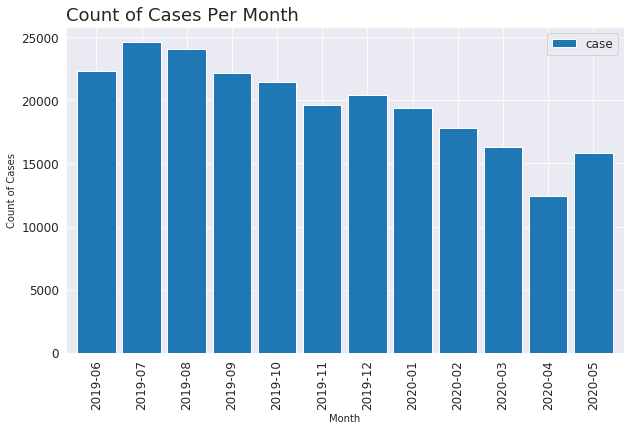

In [17]:
df.groupby('year_month').count().plot(y = 'case', 
                                      kind='bar',
                                      figsize=(10,6),
                                      width=0.85,
                                      fontsize=12,
                                      colormap='tab20').legend(bbox_to_anchor=(1,1),
                                                               prop={'size': 12})

plt.xlabel('Month')
plt.ylabel('Count of Cases')
plt.title('Count of Cases Per Month', loc='left', fontsize=18)

### Number of crimes occuring on each day

Text(0.0, 1.0, 'Count of Cases Per Day of Week [1 is a Tuesday]')

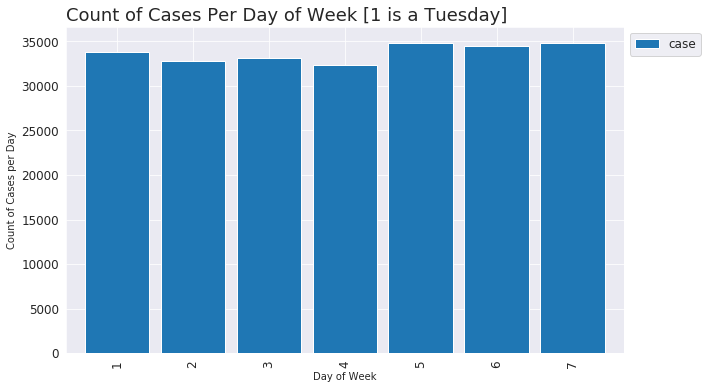

In [18]:
df.groupby('day').count().plot(y = 'case',
                               kind='bar',
                               figsize=(10,6),
                               width=0.85,
                               fontsize=12,
                               colormap='tab20').legend(bbox_to_anchor=(1,1),
                                                        prop={'size': 12})

plt.xlabel('Day of Week')
plt.ylabel('Count of Cases per Day')
plt.title('Count of Cases Per Day of Week [1 is a Tuesday]', loc='left', fontsize=18)

There is a small increase in crime reported at the weekend, Saturday and Sunday, but nothing that couldbe considered significant.

### Number of crimes occuring in each hour

Text(0.0, 1.0, 'Count of Cases Per Hour]')

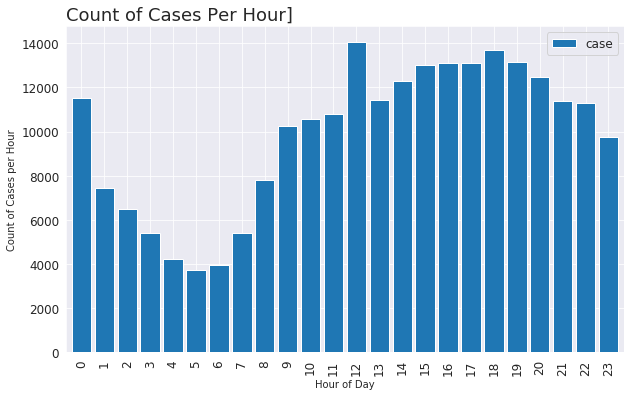

In [19]:
df.groupby('hour').count().plot(y = 'case',
                               kind='bar',
                               figsize=(10,6),
                               width=0.85,
                               fontsize=12,
                               colormap='tab20').legend(bbox_to_anchor=(1,1),
                                                        prop={'size': 12})

plt.xlabel('Hour of Day')
plt.ylabel('Count of Cases per Hour')
plt.title('Count of Cases Per Hour]', loc='left', fontsize=18)

There is an expected fall-off in reported crime rates after midnight before elevating again after eight in the morning.

### Crime Categories

In [20]:
# Number of unique Crime categories bases on the Primary Description
df.primary_description.nunique()

32

In [21]:
# What Crimes are the 3 most commonly occuring ones 
df[['primary_description', 'case']].groupby(
    ['primary_description'], as_index=False).count().sort_values(
    'case', ascending=False).head(3)

,primary_description,case
30,THEFT,55293
2,BATTERY,46223
6,CRIMINAL DAMAGE,25611


In [22]:
# Create a list of the 10 most commonly occuring crimes
top_crimes = df[['primary_description', 'case']].groupby(
    ['primary_description']).count().sort_values('case', ascending=False)[:10].axes[0].tolist()

# Create a list of the 3 most commonly occuring crimes
top_three_crimes = df[['primary_description', 'case']].groupby(
    ['primary_description']).count().sort_values('case', ascending=False)[:3].axes[0].tolist()

# Create a list of the 2 most commonly occuring crimes
top_two_crimes = df[['primary_description', 'case']].groupby(
    ['primary_description']).count().sort_values('case', ascending=False)[:2].axes[0].tolist()

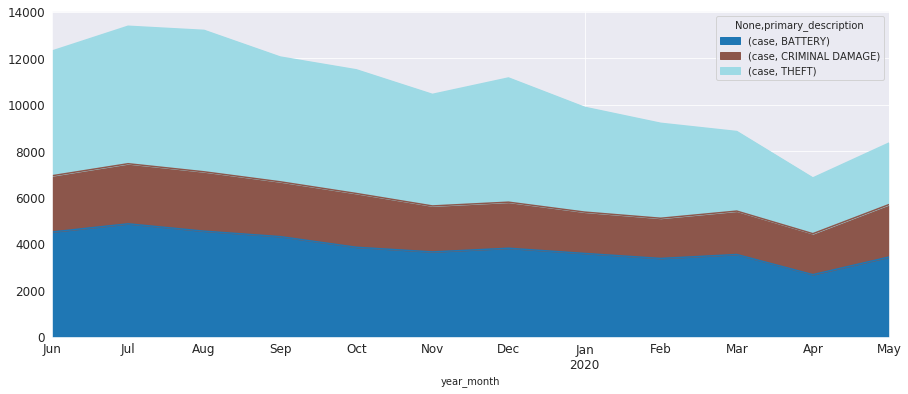

In [23]:
# Create a new data frame with just the top 10 crimes
df_top_crimes = df[df['primary_description'].isin(top_crimes)].copy()

# Create a new data frame with just the top 3 crimes
df_top3_crimes = df[df['primary_description'].isin(top_three_crimes)].copy()

df_top3_crimes[['case', 'primary_description', 'year_month']].pivot_table(
    index='year_month', 
    columns='primary_description', 
    fill_value=0, 
    aggfunc='count').plot(kind='area',
                          stacked=True,
                          figsize=(15, 6),
                               fontsize=12,
                               colormap='tab20')

Text(0.0, 1.0, 'Count of Cases Per Hour]')

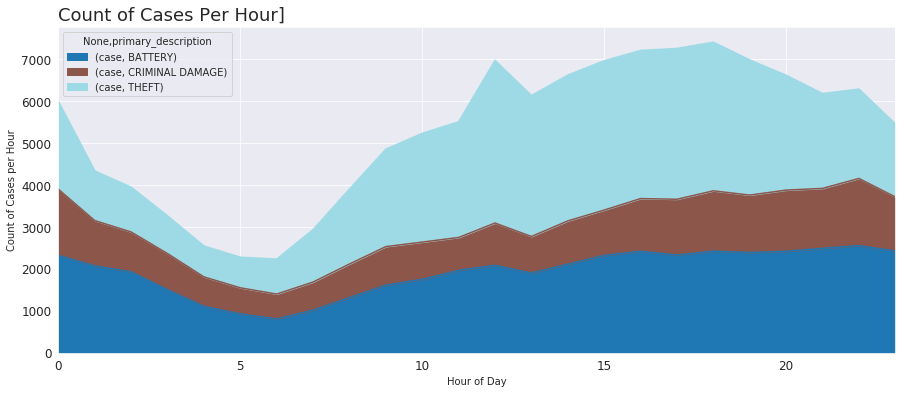

In [24]:
df_top3_crimes[['case', 'primary_description', 'hour']].pivot_table(
    index='hour', 
    columns='primary_description', 
    fill_value=0, 
    aggfunc='count').plot(kind='area',
                          stacked=True,
                          figsize=(15, 6),
                               fontsize=12,
                               colormap='tab20')

plt.xlabel('Hour of Day')
plt.ylabel('Count of Cases per Hour')
plt.title('Count of Cases Per Hour]', loc='left', fontsize=18)

### Visualize Crimes on map of Chicago

In [25]:
df_top_crimes.dtypes

case                           object
date_of_occurrence     datetime64[ns]
block                          object
primary_description            object
ward                          float64
latitude                      float64
longitude                     float64
hour                            int64
day_name                       object
day                             int64
month_name                     object
month                           int64
year                            int64
year_month                  period[M]
zip                            object
street                         object
dtype: object

##### Create a folium map with a different colour per crime

In [26]:
# Create a list of colours. 
# We have  list of the top 10 crimes from earlier
colors = [
    'red',
    'blue',
    'gray',
    'orange',
    'beige',
    'green',
    'purple',
    'pink',
    'cadetblue',
    'black'
]

# Create a dictionary of colours to map to the crimes
dict_colours = dict(zip(top_crimes, colors))

# Add the colours colums to the df_top_crimes DataFrame
df_top_crimes['colour'] = df_top_crimes.primary_description.map(dict_colours)

In [27]:
df_top_crimes_august = df_top_crimes[df_top_crimes.month_name == 'August']

# Pickle the DataFrame to Separate the Folium Maps into a Separate Notepad
df_top_crimes_august.to_pickle('crimes_august.pkl')

In [28]:
# Define Chicago's geolocation coordinates
chicago_latitude = 41.85  
chicago_longitude = -87.75

# Define the world map centered around Chicago with a higher zoom level
chicago_map = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=11)

# display world map
chicago_map

# Instantiate a feature group for the incidents in the dataframe
incidents = folium.map.FeatureGroup()

# loop through the 100 crimes and add each to the incidents feature group
for lat, lng, col in zip(df_top_crimes_august.latitude, 
                         df_top_crimes_august.longitude, 
                         df_top_crimes_august.colour):
    incidents.add_child(folium.CircleMarker(
            [lat, lng],
            radius=1, 
            color=col,
            fill=True,
            fill_color=col,
            fill_opacity=0.6
        )
    )

# add incidents to map
chicago_map.add_child(incidents)

In [30]:
mc = MarkerCluster()

# Define the world map centered around Chicago with a higher zoom level
chicago_cluster = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=11)

# display world map
chicago_cluster

#creating a Marker for each point in df_sample. Each point will get a popup with their zip
for row in df_top_crimes_august.itertuples():
    mc.add_child(folium.Marker(
        location=[row.latitude,  row.longitude],
                 popup=row.primary_description))

chicago_cluster.add_child(mc)
chicago_cluster

In [31]:
from folium import plugins
from folium.plugins import HeatMap

chicago_heatmat = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=11) 

# List comprehension to make out list of lists
heat_data = [[row['latitude'], 
              row['longitude']] for index, row in df_top_crimes_august.iterrows()]

# Plot it on the map
HeatMap(heat_data,
        min_opacity=0.5,
        max_zoom=18, 
        max_val=1.0, 
        radius=15,
        blur=20,
        gradient=None,
        overlay=True).add_to(chicago_heatmat)

# Display the map
chicago_heatmat

In [32]:
df_top_crimes.dtypes

case                           object
date_of_occurrence     datetime64[ns]
block                          object
primary_description            object
ward                          float64
latitude                      float64
longitude                     float64
hour                            int64
day_name                       object
day                             int64
month_name                     object
month                           int64
year                            int64
year_month                  period[M]
zip                            object
street                         object
colour                         object
dtype: object

## Data Preparation for Modelling

Before we start modelling we need to prepare the data frame to include only mumerical data and by removing unneeded columns.

Rather than removing colums from df_top_crimes a new df_features DataFrame will be created with just the required columns. This df_features DataFrame will then be processed to remove Categorical Data Types and replace them with One Hot encoding. Finally the Dependant Variables will be Normalised and Principal Component Analysis will be used to reduce the dimensionality of the DataFrame.

In [33]:
# Start by copying the Latitude and Longitude to the new DataFrame
df_features = df_top_crimes[['latitude', 'longitude']]

# Next and One Hot Encoding of the hour, day and month variables
df_features = df_features.join(pd.get_dummies(df_top_crimes.hour, prefix='hour'))
df_features = df_features.join(pd.get_dummies(df_top_crimes.day_name))
df_features = df_features.join(pd.get_dummies(df_top_crimes.month_name))

# Finally add the ward & crimes column, copied from the original Primary Description column
df_features['ward'] = df_top_crimes[['ward']]
df_features['crimes'] = df_top_crimes[['primary_description']]

In [34]:
df_features.head()

,latitude,longitude,hour_0,hour_1,hour_2,hour_3,hour_4,hour_5,hour_6,hour_7,hour_8,hour_9,hour_10,hour_11,hour_12,hour_13,hour_14,hour_15,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,April,August,December,February,January,July,June,March,May,November,October,September,ward,crimes
1,41.841609,-87.658034,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,11.0,CRIMINAL DAMAGE
8,41.969365,-87.728061,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,35.0,CRIMINAL DAMAGE
9,41.803121,-87.609460,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,4.0,CRIMINAL DAMAGE
10,41.733015,-87.552709,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,10.0,BATTERY
11,41.708243,-87.639226,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,9.0,THEFT




There are a couple of further small changes to be made:
<ul>
    <li> Create a smaller DataFrame of only the top three crimes </li>
   <li> Create the X, dependant variables, DataFrames by dropping the Crimes column </li>
   <li> Create the y, independant variable, </li>
   <li> Normailse the X Data </li>
    </ul>



In [35]:
# Create a smaller DataFrame of only the top three crimes
df_features_3 = df_features[df_features['crimes'].isin(top_three_crimes)].copy()

# Create a smaller DataFrame of only the top two crimes
df_features_2 = df_features[df_features['crimes'].isin(top_two_crimes)].copy()

In [36]:
#  Create the X, dependant variables, DataFrames by dropping the Crimes column
X_10 = df_features.copy()
y_10 = X_10.crimes.values

X_10.drop('crimes', axis=1, inplace=True)
X_10 = preprocessing.StandardScaler().fit(X_10).transform(X_10)


X_3 = df_features_3.copy()
y_3 = X_3.crimes.values

X_3.drop('crimes', axis=1, inplace=True)
X_3 = preprocessing.StandardScaler().fit(X_3).transform(X_3)

X_2 = df_features_2.copy()
y_2 = X_2.crimes.values

X_2.drop('crimes', axis=1, inplace=True)
X_2 = preprocessing.StandardScaler().fit(X_2).transform(X_2)

/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/preprocessing/data.py:645: DataConversionWarning: Data with input dtype uint8, float64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:6: DataConversionWarning: Data with input dtype uint8, float64 were all converted to float64 by StandardScaler.
/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/preprocessing/data.py:645: DataConversionWarning: Data with input dtype uint8, float64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:13: DataConversionWarning: Data with input dtype uint8, float64 were all converted to float64 by StandardScaler.
/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/preprocessing/data.py:645: DataConversionWarning: Data with input dtype uint8, float64 were all converted 

In [37]:
# Set X = X_10
X = X_10
y = y_10

In [38]:
# Set X = X_3
X = X_3
y = y_3

In [39]:
# Set X = X_2
X = X_2
y = y_2

## K Nearest Neighbor(KNN)

### Find the best k to build the model with the best accuracy.

Neighbours:  5   2020-06-09 09:53:41.963387
Neighbours:  6   2020-06-09 10:10:46.628468
Neighbours:  7   2020-06-09 10:28:08.873893
Neighbours:  8   2020-06-09 10:46:12.056430
Neighbours:  9   2020-06-09 11:04:39.679689
Neighbours:  10   2020-06-09 11:23:34.661549
Neighbours:  11   2020-06-09 11:42:53.788871


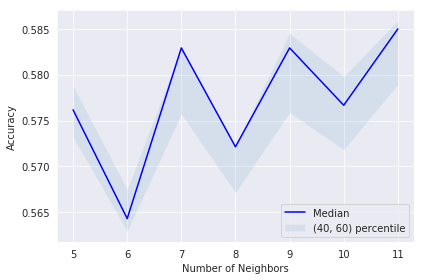

In [40]:
from datetime import datetime 
# Number of neighbours
neighs = range(5, 12)

# Store the scores
scores = np.zeros((len(neighs), 3))

for idx, neigh in enumerate(neighs):
    print('Neighbours: ', neigh, ' ', str(datetime.now()))
    model = KNeighborsClassifier(n_neighbors = neigh)
    scores[idx, : ] = cross_validate(model, n_splits = 5)

plt.plot(neighs, scores[ : , 1], 'b')
plt.fill_between(neighs, scores[ : , 0], scores[:, 2], alpha = 0.1)
plt.legend(('Median', '(40, 60) percentile'))
plt.ylabel('Accuracy')
plt.xlabel('Number of Neighbors')
plt.tight_layout()
plt.show()

## Decision Tree

Depth:  10   2020-06-09 12:02:35.209511
Depth:  11   2020-06-09 12:02:58.272849
Depth:  12   2020-06-09 12:03:23.381949
Depth:  13   2020-06-09 12:03:50.536534
Depth:  14   2020-06-09 12:04:18.465484
Depth:  15   2020-06-09 12:04:47.940118


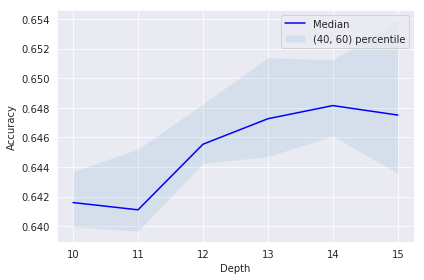

In [41]:
# Decision Tree
from datetime import datetime
from sklearn.tree import DecisionTreeClassifier

depths = range(10, 16)
scores = np.zeros((len(depths), 3))
# scores = np.zeros((len(depths), 2))
for idx, depth in enumerate(depths):
    print('Depth: ', depth, ' ', str(datetime.now()))
    model = DecisionTreeClassifier(criterion = "entropy", max_depth = depth)
    scores[idx, : ] = cross_validate(model, n_splits = 10)

plt.plot(depths, scores[ : , 1], 'b')
plt.fill_between(depths, scores[ : , 0], scores[:, 2], alpha = 0.1)
plt.legend(('Median', '(40, 60) percentile'))
plt.ylabel('Accuracy')
plt.xlabel('Depth')
plt.tight_layout()
plt.show()

## Logistic Regression

C:  0.01   2020-06-09 12:07:15.113392
C:  0.03162277660168379   2020-06-09 12:07:25.948151
C:  0.1   2020-06-09 12:07:36.615356
C:  0.31622776601683794   2020-06-09 12:07:47.696964
C:  1.0   2020-06-09 12:07:58.829703
C:  3.1622776601683795   2020-06-09 12:08:10.011842


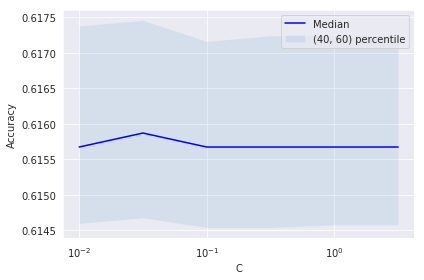

In [42]:
# Logistic Regression

from sklearn.linear_model import LogisticRegression

C = np.logspace(-2.0, 0.5, num = 6, endpoint = True)
scores = np.zeros((len(C), 3))
for idx, c in enumerate(C):
    print('C: ', c, ' ', str(datetime.now()))
    model = LogisticRegression(C = c, solver = 'liblinear')
    scores[idx, : ] = cross_validate(model, n_splits = 10)

plt.plot(C, scores[ : , 1], 'b')
plt.xscale('log')
plt.fill_between(C, scores[ : , 0], scores[:, 2], alpha = 0.1)
plt.legend(('Median', '(40, 60) percentile'))
plt.ylabel('Accuracy')
plt.xlabel('C')
plt.tight_layout()
plt.show()

## Naive Bayes

Alpha:  0.1   2020-06-09 12:08:21.823293
Alpha:  0.2   2020-06-09 12:08:26.475823
Alpha:  0.30000000000000004   2020-06-09 12:08:31.153939
Alpha:  0.4   2020-06-09 12:08:35.878085
Alpha:  0.5   2020-06-09 12:08:40.559441
Alpha:  0.6   2020-06-09 12:08:45.045613
Alpha:  0.7000000000000001   2020-06-09 12:08:49.769498
Alpha:  0.8   2020-06-09 12:08:54.588773
Alpha:  0.9   2020-06-09 12:08:59.233789
Alpha:  1.0   2020-06-09 12:09:03.709130


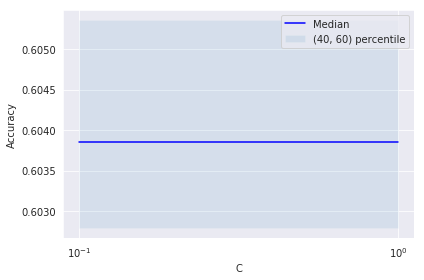

In [43]:
# Naive Bayes

alpha = np.linspace(0.1, 1, num=10)
scores = np.zeros((len(alpha), 3))
for idx, a in enumerate(alpha):
    print('Alpha: ', a, ' ', str(datetime.now()))
    model = BernoulliNB()
    scores[idx, : ] = cross_validate(model, n_splits = 10)

plt.plot(alpha, scores[ : , 1], 'b')
plt.xscale('log')
plt.fill_between(alpha, scores[ : , 0], scores[:, 2], alpha = 0.1)
plt.legend(('Median', '(40, 60) percentile'))
plt.ylabel('Accuracy')
plt.xlabel('C')
plt.tight_layout()
plt.show()

## Random Forest

Estimator:  12   2020-06-09 12:09:08.773907
Estimator:  13   2020-06-09 12:09:50.456010
Estimator:  14   2020-06-09 12:10:36.761925
Estimator:  15   2020-06-09 12:11:27.762148
Estimator:  16   2020-06-09 12:12:22.985768
Estimator:  17   2020-06-09 12:13:23.949602


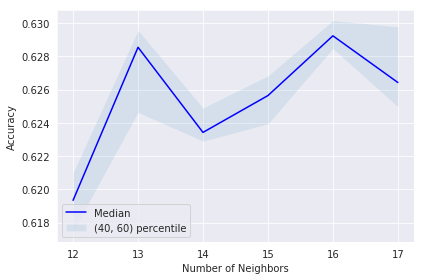

In [44]:
# Decision Forest using a Random Forest

est = range(12, 18)
scores = np.zeros((len(est), 3))
for idx, a in enumerate(est):
    print('Estimator: ', a, ' ', str(datetime.now()))
    model = RandomForestClassifier(n_estimators = a, max_features = 'sqrt')
    scores[idx, : ] = cross_validate(model, n_splits = 10)

plt.plot(est, scores[ : , 1], 'b')
plt.fill_between(est, scores[ : , 0], scores[:, 2], alpha = 0.1)
plt.legend(('Median', '(40, 60) percentile'))
plt.ylabel('Accuracy')
plt.xlabel('Number of Neighbors')
plt.tight_layout()
plt.show()

In [45]:
def cross_validate_02(model, n_splits = 10):

    Ks = 10
    mean_acc = np.zeros((Ks-1))
    std_acc = np.zeros((Ks-1))
    ConfustionMx = [];
    for n in range(1,Ks):

        #Train Model and Predict
        k_fold = KFold(n_splits = n_splits)
        for train, test in k_fold.split(X):
            neigh = KNeighborsClassifier(n_neighbors = n).fit(X[train], y[train])
            yhat=neigh.predict(X[test])
            mean_acc[n-1] = metrics.accuracy_score(y[test], yhat)
            std_acc[n-1]=np.std(yhat==y[test])/np.sqrt(yhat.shape[0])

    mean_acc
    
def cross_validate(model, n_splits = 10):
    
    k_fold = KFold(n_splits = n_splits)
    scores = [model.fit(X[train], y[train]).score(X[test], y[test]) for train, test in k_fold.split(X)]
    
    scores = np.percentile(scores, [40, 50, 60])
    return scores

# Import and proces FOURSQUARE Data

In [46]:
import requests

page = requests.get("https://foursquare.com/explore?mode=url&near=Chicago%2C%20IL%2C%20United%20States&nearGeoId=72057594042815334&q=Top%20Picks")

from bs4 import BeautifulSoup
soup = BeautifulSoup(page.content, 'html.parser')
top_venues = soup.find_all('div', class_='venueDetails')

In [48]:
venue_columns = ['id', 
                 'score', 
                 'category', 
                 'name', 
                 'address',
                 'postalcode',
                 'city',
                 'href', 
                 'latitude', 
                 'longitude']

df_top_venues = pd.DataFrame(columns=venue_columns)

for venue in top_venues:
    venue_name = venue.find(target="_blank").get_text()
    venue_score = venue.find(class_="venueScore positive").get_text()
    venue_cat = venue.find(class_="categoryName").get_text()
    venue_href = venue.find(class_="venueName").h2.a['href']
    venue_id = venue_href.split('/')[-1]

    if 'promotedTipId' in venue_id: 
        continue
        
    # Get the properly formatted address and the latitude and longitude
    url = 'https://api.foursquare.com/v2/venues/{}?client_id={}&client_secret={}&v={}'.format(
        venue_id, 
        'V0J1F4DNOTEQXEN25MDO1OF0DQLYIUBL5GL2UJH2FQXXLSI2',
        'LHDHYGYJIYNBPF4FJP1RWR4AEM0C504FMFVZGRIXLY1CJDIX',
        20180604)
    
    result = requests.get(url).json()
    
    print(result)
    venue_address = result['response']['venue']['location']['address']
    venue_postalcode = result['response']['venue']['location']['postalCode']
    venue_city = result['response']['venue']['location']['city']
    venue_latitude = result['response']['venue']['location']['lat']
    venue_longitude = result['response']['venue']['location']['lng']
    
    df_top_venues = df_top_venues.append({'id': venue_id,
                                          'score': venue_score,
                                          'category': venue_cat,
                                          'name': venue_name,
                                          'address': venue_address,
                                          'postalcode': venue_postalcode,
                                          'city': venue_city,
                                          'href': venue_href,
                                          'latitude': venue_latitude,
                                          'longitude': venue_longitude}, ignore_index=True)

{'meta': {'code': 200, 'requestId': '5edf7e09949393001c4afade'}, 'response': {'venue': {'id': '4b06c066f964a52097ef22e3', 'name': "Binny's Beverage Depot", 'contact': {'phone': '3126644394', 'formattedPhone': '(312) 664-4394', 'facebook': '98167012448', 'facebookUsername': 'BinnysBev', 'facebookName': "Binny's"}, 'location': {'address': '1720 N Marcey St', 'crossStreet': 'at W Willow St', 'lat': 41.9130763692073, 'lng': -87.65517035528063, 'labeledLatLngs': [{'label': 'display', 'lat': 41.9130763692073, 'lng': -87.65517035528063}, {'label': 'entrance', 'lat': 41.913401, 'lng': -87.655442}], 'postalCode': '60614', 'cc': 'US', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['1720 N Marcey St (at W Willow St)', 'Chicago, IL 60614', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/binnys-beverage-depot/4b06c066f964a52097ef22e3', 'categories': [{'id': '4bf58dd8d48988d186941735', 'name': 'Liquor Store', 'pluralName': 'Liquor Stores', 'shortName'

{'meta': {'code': 200, 'requestId': '5edf7e09949393001c4afb98'}, 'response': {'venue': {'id': '4b9d15c5f964a520478e36e3', 'name': 'Chicago Riverwalk', 'contact': {}, 'location': {'address': 'Chicago River', 'lat': 41.88728, 'lng': -87.627217, 'labeledLatLngs': [{'label': 'display', 'lat': 41.88728, 'lng': -87.627217}], 'postalCode': '60601', 'cc': 'US', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['Chicago River', 'Chicago, IL 60601', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/chicago-riverwalk/4b9d15c5f964a520478e36e3', 'categories': [{'id': '56aa371be4b08b9a8d5734c3', 'name': 'Waterfront', 'pluralName': 'Waterfronts', 'shortName': 'Waterfront', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/river_', 'suffix': '.png'}, 'primary': True}, {'id': '4eb1d4dd4b900d56c88a45fd', 'name': 'River', 'pluralName': 'Rivers', 'shortName': 'River', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoo

{'meta': {'code': 200, 'requestId': '5edf7bf929ce6a001b49d804'}, 'response': {'venue': {'id': '49e9ef74f964a52011661fe3', 'name': 'The Art Institute of Chicago', 'contact': {'phone': '3124433600', 'formattedPhone': '(312) 443-3600', 'twitter': 'artinstitutechi', 'instagram': 'artinstitutechi', 'facebook': '17179183149', 'facebookUsername': 'artic', 'facebookName': 'The Art Institute of Chicago'}, 'location': {'address': '111 S Michigan Ave', 'crossStreet': 'btwn Monroe St & Jackson Dr', 'lat': 41.87968946580023, 'lng': -87.62325843965061, 'postalCode': '60603', 'cc': 'US', 'neighborhood': 'Grant Park', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['111 S Michigan Ave (btwn Monroe St & Jackson Dr)', 'Chicago, IL 60603', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/the-art-institute-of-chicago/49e9ef74f964a52011661fe3', 'categories': [{'id': '4bf58dd8d48988d18f941735', 'name': 'Art Museum', 'pluralName': 'Art Museums', 'shortName': 'Ar

{'meta': {'code': 200, 'requestId': '5edf7d3b0f5968002598af1d'}, 'response': {'venue': {'id': '42b75880f964a52090251fe3', 'name': 'Millennium Park', 'contact': {'phone': '3127421168', 'formattedPhone': '(312) 742-1168', 'twitter': 'millennium_park', 'facebook': '107993661288', 'facebookName': 'Millennium Park'}, 'location': {'address': '201 E Randolph St', 'crossStreet': 'btwn Columbus Dr & Michigan Ave', 'lat': 41.88311217282798, 'lng': -87.62385133673686, 'postalCode': '60601', 'cc': 'US', 'neighborhood': 'Grant Park', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['201 E Randolph St (btwn Columbus Dr & Michigan Ave)', 'Chicago, IL 60601', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/millennium-park/42b75880f964a52090251fe3', 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Park', 'pluralName': 'Parks', 'shortName': 'Park', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/park_', 'suffix': '.png'},

{'meta': {'code': 200, 'requestId': '5edf7e3b618f43001bc1462a'}, 'response': {'venue': {'id': '4b9511c7f964a520f38d34e3', 'name': 'Chicago Lakefront Trail', 'contact': {}, 'location': {'address': 'Lake Michigan Lakefront', 'crossStreet': 'at N Lakeshore Dr', 'lat': 41.967052938918144, 'lng': -87.6469087600708, 'labeledLatLngs': [{'label': 'display', 'lat': 41.967052938918144, 'lng': -87.6469087600708}], 'postalCode': '60611', 'cc': 'US', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['Lake Michigan Lakefront (at N Lakeshore Dr)', 'Chicago, IL 60611', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/chicago-lakefront-trail/4b9511c7f964a520f38d34e3', 'categories': [{'id': '4bf58dd8d48988d159941735', 'name': 'Trail', 'pluralName': 'Trails', 'shortName': 'Trail', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/hikingtrail_', 'suffix': '.png'}, 'primary': True}, {'id': '56aa371be4b08b9a8d5734c3', 'name': 'Waterfront',

{'meta': {'code': 200, 'requestId': '5edf7daab1cac0001b32bc63'}, 'response': {'venue': {'id': '4c23e840a852c928594ae26c', 'name': 'Nature Boardwalk', 'contact': {}, 'location': {'address': '2001 N Clark St', 'crossStreet': 'btwn Fullerton Ave & LaSalle Dr', 'lat': 41.9181019674175, 'lng': -87.63328313827515, 'labeledLatLngs': [{'label': 'display', 'lat': 41.9181019674175, 'lng': -87.63328313827515}], 'postalCode': '60614', 'cc': 'US', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['2001 N Clark St (btwn Fullerton Ave & LaSalle Dr)', 'Chicago, IL 60614', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/nature-boardwalk/4c23e840a852c928594ae26c', 'categories': [{'id': '4bf58dd8d48988d159941735', 'name': 'Trail', 'pluralName': 'Trails', 'shortName': 'Trail', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/hikingtrail_', 'suffix': '.png'}, 'primary': True}], 'verified': False, 'stats': {'tipCount': 22}, 'likes': {'co

{'meta': {'code': 200, 'requestId': '5edf7dabb1cac0001b32bde8'}, 'response': {'venue': {'id': '4a9046daf964a520ff1620e3', 'name': 'Unabridged Books', 'contact': {'phone': '7738839119', 'formattedPhone': '(773) 883-9119', 'twitter': 'unabridgedbooks'}, 'location': {'address': '3251 N Broadway St', 'crossStreet': 'at W Melrose St', 'lat': 41.94158754418788, 'lng': -87.64438632972113, 'labeledLatLngs': [{'label': 'display', 'lat': 41.94158754418788, 'lng': -87.64438632972113}], 'postalCode': '60657', 'cc': 'US', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['3251 N Broadway St (at W Melrose St)', 'Chicago, IL 60657', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/unabridged-books/4a9046daf964a520ff1620e3', 'categories': [{'id': '4bf58dd8d48988d114951735', 'name': 'Bookstore', 'pluralName': 'Bookstores', 'shortName': 'Bookstore', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/bookstore_', 'suffix': '.png'}, 'primary': Tru

{'meta': {'code': 200, 'requestId': '5edf7dfc216785001bf780c6'}, 'response': {'venue': {'id': '4a6e8003f964a520d5d41fe3', 'name': 'Bari', 'contact': {'phone': '3126660730', 'formattedPhone': '(312) 666-0730'}, 'location': {'address': '1120 W Grand Ave', 'crossStreet': 'at N May St', 'lat': 41.89117781715653, 'lng': -87.6556284832498, 'labeledLatLngs': [{'label': 'display', 'lat': 41.89117781715653, 'lng': -87.6556284832498}, {'label': 'entrance', 'lat': 41.891211, 'lng': -87.655534}], 'postalCode': '60642', 'cc': 'US', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['1120 W Grand Ave (at N May St)', 'Chicago, IL 60642', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/bari/4a6e8003f964a520d5d41fe3', 'categories': [{'id': '4bf58dd8d48988d1c5941735', 'name': 'Sandwich Place', 'pluralName': 'Sandwich Places', 'shortName': 'Sandwiches', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/deli_', 'suffix': '.png'}, 'primary': True},

{'meta': {'code': 200, 'requestId': '5edf7ce7b4b684001b452122'}, 'response': {'venue': {'id': '5b15ed56cbcdee002c59b8e8', 'name': 'Lost Larson Bakery', 'contact': {}, 'location': {'address': '5318 N Clark St', 'lat': 41.97861720321764, 'lng': -87.66841107899356, 'labeledLatLngs': [{'label': 'display', 'lat': 41.97861720321764, 'lng': -87.66841107899356}, {'label': 'entrance', 'lat': 41.978635, 'lng': -87.668445}], 'postalCode': '60640', 'cc': 'US', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['5318 N Clark St', 'Chicago, IL 60640', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/lost-larson-bakery/5b15ed56cbcdee002c59b8e8', 'categories': [{'id': '4bf58dd8d48988d16a941735', 'name': 'Bakery', 'pluralName': 'Bakeries', 'shortName': 'Bakery', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/bakery_', 'suffix': '.png'}, 'primary': True}], 'verified': False, 'stats': {'tipCount': 10}, 'price': {'tier': 1, 'message': 'Cheap', '

{'meta': {'code': 200, 'requestId': '5edf7dfcc94979001bcf34b5'}, 'response': {'venue': {'id': '4adfca6df964a520777d21e3', 'name': 'Symphony Center (Chicago Symphony Orchestra)', 'contact': {'phone': '3122943000', 'formattedPhone': '(312) 294-3000', 'twitter': 'chicagosymphony'}, 'location': {'address': '220 S Michigan Ave', 'crossStreet': 'btwn Adams & Jackson', 'lat': 41.87927535633318, 'lng': -87.62468041570357, 'labeledLatLngs': [{'label': 'display', 'lat': 41.87927535633318, 'lng': -87.62468041570357}], 'postalCode': '60604', 'cc': 'US', 'neighborhood': 'Chicago Loop, IL', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['220 S Michigan Ave (btwn Adams & Jackson)', 'Chicago, IL 60604', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/symphony-center-chicago-symphony-orchestra/4adfca6df964a520777d21e3', 'categories': [{'id': '5032792091d4c4b30a586d5c', 'name': 'Concert Hall', 'pluralName': 'Concert Halls', 'shortName': 'Concert Hall', 'i

{'meta': {'code': 200, 'requestId': '5edf7dc47828ae001b04ffc1'}, 'response': {'venue': {'id': '4f2a0d0ae4b0837d0c4c2bc3', 'name': 'Publican Quality Meats', 'contact': {'phone': '3124960012', 'formattedPhone': '(312) 496-0012'}, 'location': {'address': '825 W Fulton Market', 'crossStreet': 'at Green', 'lat': 41.886641964097095, 'lng': -87.64871823183745, 'labeledLatLngs': [{'label': 'display', 'lat': 41.886641964097095, 'lng': -87.64871823183745}, {'label': 'entrance', 'lat': 41.886677, 'lng': -87.648499}], 'postalCode': '60607', 'cc': 'US', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['825 W Fulton Market (at Green)', 'Chicago, IL 60607', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/publican-quality-meats/4f2a0d0ae4b0837d0c4c2bc3', 'categories': [{'id': '4bf58dd8d48988d146941735', 'name': 'Deli / Bodega', 'pluralName': 'Delis / Bodegas', 'shortName': 'Deli / Bodega', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/de

{'meta': {'code': 200, 'requestId': '5edf7d56ed78b8001b1cf6c3'}, 'response': {'venue': {'id': '4a2ae23af964a52064961fe3', 'name': "Joe's Seafood, Prime Steak & Stone Crab", 'contact': {'phone': '3123795637', 'formattedPhone': '(312) 379-5637', 'twitter': 'joeschicago', 'instagram': 'joesseafood', 'facebook': '108921829133449', 'facebookUsername': 'joeschicago', 'facebookName': "Joe's Seafood, Prime Steak & Stone Crab"}, 'location': {'address': '60 E Grand Ave', 'crossStreet': 'at N Rush St', 'lat': 41.891827934799345, 'lng': -87.62544444279393, 'labeledLatLngs': [{'label': 'display', 'lat': 41.891827934799345, 'lng': -87.62544444279393}, {'label': 'entrance', 'lat': 41.891802, 'lng': -87.625665}], 'postalCode': '60611', 'cc': 'US', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['60 E Grand Ave (at N Rush St)', 'Chicago, IL 60611', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/joes-seafood-prime-steak--stone-crab/4a2ae23af964a52064961fe

{'meta': {'code': 200, 'requestId': '5edf7d6ffb34b5001b052b16'}, 'response': {'venue': {'id': '50b69e52e4b023feffc3b3ae', 'name': 'Maggie Daley Park', 'contact': {'phone': '3125523000', 'formattedPhone': '(312) 552-3000', 'twitter': 'chicagoparks', 'facebook': '49690408710', 'facebookUsername': 'ChicagoParkDistrict', 'facebookName': 'Chicago Park District'}, 'location': {'address': '337 E Randolph Dr', 'crossStreet': 'btwn Lake Shore Dr & Columbus Dr', 'lat': 41.882904611592366, 'lng': -87.61884577368617, 'labeledLatLngs': [{'label': 'display', 'lat': 41.882904611592366, 'lng': -87.61884577368617}], 'postalCode': '60601', 'cc': 'US', 'neighborhood': 'Grant Park', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['337 E Randolph Dr (btwn Lake Shore Dr & Columbus Dr)', 'Chicago, IL 60601', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/maggie-daley-park/50b69e52e4b023feffc3b3ae', 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Par

{'meta': {'code': 200, 'requestId': '5edf7eef5fb726001bc250a0'}, 'response': {'venue': {'id': '5228f072bce6872aefde90d0', 'name': "Jeni's Splendid Ice Creams", 'contact': {'phone': '7733487139', 'formattedPhone': '(773) 348-7139', 'twitter': 'jenischi', 'facebook': '172636539568279', 'facebookUsername': 'jenissouthport', 'facebookName': "Jeni's Splendid Ice Creams"}, 'location': {'address': '3404 N Southport Ave', 'crossStreet': 'at W Roscoe St', 'lat': 41.9436026060672, 'lng': -87.66402619739496, 'labeledLatLngs': [{'label': 'display', 'lat': 41.9436026060672, 'lng': -87.66402619739496}], 'postalCode': '60657', 'cc': 'US', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['3404 N Southport Ave (at W Roscoe St)', 'Chicago, IL 60657', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/jenis-splendid-ice-creams/5228f072bce6872aefde90d0', 'categories': [{'id': '4bf58dd8d48988d1c9941735', 'name': 'Ice Cream Shop', 'pluralName': 'Ice Cream Shops', 

{'meta': {'code': 200, 'requestId': '5edf7cbd211536001bdca0ad'}, 'response': {'venue': {'id': '4e55255f6365b59a57f7b10b', 'name': 'Heritage Bicycles', 'contact': {'phone': '7732453005', 'formattedPhone': '(773) 245-3005', 'twitter': 'heritagebicycle', 'facebook': '253991494620052', 'facebookUsername': 'heritagebicycles', 'facebookName': 'Heritage Bicycles General Store'}, 'location': {'address': '2959 N Lincoln Avenue', 'crossStreet': 'Wellington', 'lat': 41.93576, 'lng': -87.66283, 'labeledLatLngs': [{'label': 'display', 'lat': 41.93576, 'lng': -87.66283}], 'postalCode': '60657', 'cc': 'US', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['2959 N Lincoln Avenue (Wellington)', 'Chicago, IL 60657', 'United States']}, 'canonicalUrl': 'https://foursquare.com/heritagebicycle', 'categories': [{'id': '4bf58dd8d48988d1e0931735', 'name': 'Coffee Shop', 'pluralName': 'Coffee Shops', 'shortName': 'Coffee Shop', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categ

{'meta': {'code': 200, 'requestId': '5edf7e351187ee001ba9c62a'}, 'response': {'venue': {'id': '4b9a32a0f964a5200aa435e3', 'name': "Weber's Bakery", 'contact': {'phone': '7735055642', 'formattedPhone': '(773) 505-5642', 'instagram': 'webersbakery', 'facebook': '233254790179124', 'facebookUsername': 'webersbakery', 'facebookName': "Weber's Bakery"}, 'location': {'address': '7055 W Archer Ave', 'crossStreet': 'at Nottingham Ave', 'lat': 41.791695, 'lng': -87.798656, 'labeledLatLngs': [{'label': 'display', 'lat': 41.791695, 'lng': -87.798656}, {'label': 'entrance', 'lat': 41.791894, 'lng': -87.798663}], 'postalCode': '60638', 'cc': 'US', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['7055 W Archer Ave (at Nottingham Ave)', 'Chicago, IL 60638', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/webers-bakery/4b9a32a0f964a5200aa435e3', 'categories': [{'id': '4bf58dd8d48988d16a941735', 'name': 'Bakery', 'pluralName': 'Bakeries', 'shortName': 'Bak

{'meta': {'code': 200, 'requestId': '5edf7e5d77af03001b1e10a4'}, 'response': {'venue': {'id': '58abb6b1f16bb56972aa7ded', 'name': 'Ella Elli', 'contact': {'phone': '7739353552', 'formattedPhone': '(773) 935-3552', 'instagram': 'ellaellichicago', 'facebook': '562429540599304', 'facebookUsername': 'ellaellichicago', 'facebookName': 'Ella Elli'}, 'location': {'address': '1349 w Cornelia', 'crossStreet': 'Southport', 'lat': 41.94520793891081, 'lng': -87.66365183207861, 'labeledLatLngs': [{'label': 'display', 'lat': 41.94520793891081, 'lng': -87.66365183207861}], 'postalCode': '60657', 'cc': 'US', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['1349 w Cornelia (Southport)', 'Chicago, IL 60657', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/ella-elli/58abb6b1f16bb56972aa7ded', 'categories': [{'id': '4bf58dd8d48988d14e941735', 'name': 'American Restaurant', 'pluralName': 'American Restaurants', 'shortName': 'American', 'icon': {'prefix': 'htt

{'meta': {'code': 200, 'requestId': '5edf7e03542890001b073945'}, 'response': {'venue': {'id': '49dce128f964a520b65f1fe3', 'name': 'Garfield Park Conservatory', 'contact': {'phone': '7736381766', 'formattedPhone': '(773) 638-1766', 'twitter': 'gpconservatory'}, 'location': {'address': '300 N Central Park Ave', 'crossStreet': 'at Lake St', 'lat': 41.886259, 'lng': -87.717177, 'labeledLatLngs': [{'label': 'display', 'lat': 41.886259, 'lng': -87.717177}], 'postalCode': '60624', 'cc': 'US', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['300 N Central Park Ave (at Lake St)', 'Chicago, IL 60624', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/garfield-park-conservatory/49dce128f964a520b65f1fe3', 'categories': [{'id': '4bf58dd8d48988d15a941735', 'name': 'Garden', 'pluralName': 'Gardens', 'shortName': 'Garden', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/garden_', 'suffix': '.png'}, 'primary': True}], 'verified': T

{'meta': {'code': 200, 'requestId': '5edf7dc514a126001b21213d'}, 'response': {'venue': {'id': '4f9a5b92e4b0d8e6212e11cc', 'name': 'Chicago Lakefront', 'contact': {}, 'location': {'address': 'E Solidarity Dr', 'lat': 41.86656214411742, 'lng': -87.6087806891488, 'labeledLatLngs': [{'label': 'display', 'lat': 41.86656214411742, 'lng': -87.6087806891488}], 'postalCode': '60605', 'cc': 'US', 'city': 'Chicago', 'state': 'IL', 'country': 'United States', 'formattedAddress': ['E Solidarity Dr', 'Chicago, IL 60605', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/chicago-lakefront/4f9a5b92e4b0d8e6212e11cc', 'categories': [{'id': '56aa371be4b08b9a8d5734c3', 'name': 'Waterfront', 'pluralName': 'Waterfronts', 'shortName': 'Waterfront', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/river_', 'suffix': '.png'}, 'primary': True}], 'verified': False, 'stats': {'tipCount': 14}, 'likes': {'count': 143, 'groups': [{'type': 'others', 'count': 143, 'items': []}], 'su

In [51]:
df_top_venues.shape

(30, 10)

In [52]:
df_top_venues.dtypes

id             object
score          object
category       object
name           object
address        object
postalcode     object
city           object
href           object
latitude      float64
longitude     float64
dtype: object

In [53]:
df_top_venues['score'] = pd.to_numeric(df_top_venues['score'], errors='coerce').fillna(0)

In [54]:
df_top_venues.score.describe()

count    30.000000
mean      9.420000
std       0.071438
min       9.300000
25%       9.400000
50%       9.400000
75%       9.500000
max       9.500000
Name: score, dtype: float64

In [55]:
df_top_venues.head()

,id,score,category,name,address,postalcode,city,href,latitude,longitude
0,4b06c066f964a52097ef22e3,9.5,Liquor Store,Binny's Beverage Depot,1720 N Marcey St,60614,Chicago,/v/binnys-beverage-depot/4b06c066f964a52097ef22e3,41.913076,-87.655170
1,4b9d15c5f964a520478e36e3,9.5,Waterfront,Chicago Riverwalk,Chicago River,60601,Chicago,/v/chicago-riverwalk/4b9d15c5f964a520478e36e3,41.887280,-87.627217
2,49e9ef74f964a52011661fe3,9.5,Art Museum,The Art Institute of Chicago,111 S Michigan Ave,60603,Chicago,/v/the-art-institute-of-chicago/49e9ef74f964a5...,41.879689,-87.623258
3,4c47533649fa9521cb1f5e62,9.5,Park,Grant Park,337 E Randolph Dr,60601,Chicago,/v/grant-park/4c47533649fa9521cb1f5e62,41.876626,-87.619263
4,42b75880f964a52090251fe3,9.5,Park,Millennium Park,201 E Randolph St,60601,Chicago,/v/millennium-park/42b75880f964a52090251fe3,41.883112,-87.623851


In [56]:
df_top_venues.to_pickle('top_venues.pkl')



In [94]:
# dataframe for restaurants
restaurants_columns = ['id',
                       'score', 
                       'category', 
                       'categoryID', 
                       'name', 
                       'address',
                       'postalcode',
                       'city',
                       'latitude',
                       'longitude', 
                       'venue_name', 
                       'venue_latitude',
                       'venue_longitude']

df_restaurant = pd.DataFrame(columns=restaurants_columns)

# Create a list of all the top venue latitude and longitude
top_venue_lats = df_top_venues['latitude'].values
top_venue_lngs = df_top_venues['longitude'].values

# Create a list of all the top venue names
top_venue_names = df_top_venues['name'].values

for ven_name, ven_lat, ven_long in zip(top_venue_names, top_venue_lats, top_venue_lngs):
    #print(ven_name)
    
    # Configure additional Search parameters
    categoryId = '4bf58dd8d48988d1c4941735'
    radius = 500
    limit = 15
    
    url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&categoryId={}&radius={}&limit={}'.format(
        'V0J1F4DNOTEQXEN25MDO1OF0DQLYIUBL5GL2UJH2FQXXLSI2',
        'LHDHYGYJIYNBPF4FJP1RWR4AEM0C504FMFVZGRIXLY1CJDIX',
        ven_lat,
        ven_long,
        20180604,
        categoryId,
        radius,
        limit)
    
    results = requests.get(url).json()
    
    #print(results['response'])
    
    # Want a good selection of Restaurents
    # If less than 10 ignore
    if len(results['response']['venues']) < 10:
        continue
        
    # Create a new dataframe with the list of restaurants
    # Get the values for each Restaurant from the JSON
    for restaurant in results['response']['venues']:
 
        # Sometimes there is no address. If so continue
            #if not restaurant['location']['address']:
              #  continue
        
        
            # Get location details
            rest_id = restaurant['id']
            print(rest_id)
            rest_category = restaurant['categories'][0]['pluralName']
            rest_categoryID = restaurant['categories'][0]['id']
            rest_name = restaurant['name']
            #rest_address = restaurant['location']['address']
            #rest_postalcode = restaurant['location']['postalCode']
            #rest_city = restaurant['location']['city']
            rest_latitude = restaurant['location']['lat']
            rest_longitude = restaurant['location']['lng']
            
            # Get the restaurant score and href
            rest_url = 'https://api.foursquare.com/v2/venues/{}?client_id={}&client_secret={}&v={}'.format(
                rest_id, 
                'V0J1F4DNOTEQXEN25MDO1OF0DQLYIUBL5GL2UJH2FQXXLSI2',
                'LHDHYGYJIYNBPF4FJP1RWR4AEM0C504FMFVZGRIXLY1CJDIX',
                20200608
                )

            result = requests.get(rest_url).json()
            #print(result)
            #rest_score = result['response']['venue']['rating']
            
            df_restaurant = df_restaurant.append({'id': rest_id,
                                                  #'score': rest_score,
                                                  'category': rest_category,
                                                  'categoryID': rest_categoryID,
                                                  'name': rest_name,
                                                  #'address': rest_address,
                                                  #'postalcode': rest_postalcode,
                                                  #'city': rest_city,
                                                  'latitude': rest_latitude,
                                                  'longitude': rest_longitude,
                                                  'venue_name': ven_name,
                                                  'venue_latitude': ven_lat,
                                                  'venue_longitude': ven_long}, ignore_index=True)
     
            
        

49f0aac8f964a52042691fe3
4f312ec1e4b0871fe5803d87
4bb7844598c7ef3b04e32f02
53bdc413498e161627668129
4b74505bf964a52081d42de3
59b2ae519be5223cd08a8955
59ea2c436e46507344ca1aae
4ca4d2a4d695199c9a9451e7
5c365e5a492822002d48a585
4cc0803b1c6c6dcbe7cc755e
4bd5a3914e32d13a3122c180
5238df8e11d284b8ca1ede2d
42ed6600f964a520a8261fe3
4f88a48be4b0e6f347cfe5b9
573b2c3238faeff59fd2cc36
5c2bb95f92e7a9002c15e803
4aea192af964a5204fb921e3
4bb7844598c7ef3b04e32f02
5087426fe4b097b4d8b9cf16
4ba90042f964a5204f023ae3
4ba10c4bf964a5206d9237e3
4b7c37b8f964a52022852fe3
59ea2c436e46507344ca1aae
50a84651e4b0702a8286165b
4b9abcfaf964a5204dd135e3
4bb7844598c7ef3b04e32f02
59ea2c436e46507344ca1aae
4a4bd457f964a520c7ac1fe3
49f0aac8f964a52042691fe3
4ba90042f964a5204f023ae3
4cc0803b1c6c6dcbe7cc755e
5c365e5a492822002d48a585
4aea192af964a5204fb921e3
4f312ec1e4b0871fe5803d87
4bc367694cdfc9b6884c9721
4ba10c4bf964a5206d9237e3
593ec2950a464d2a57edaf0f
4dd99b02c65bee535ae7c820
56fc0d8e498e7c134fe83104
4f312ec1e4b0871fe5803d87


In [95]:
df_restaurant.shape

(131, 13)

In [96]:
df_restaurant.head()

,id,score,category,categoryID,name,address,postalcode,city,latitude,longitude,venue_name,venue_latitude,venue_longitude
0,49f0aac8f964a52042691fe3,NaN,Seafood Restaurants,4bf58dd8d48988d1ce941735,McCormick & Schmick's Seafood & Steak,NaN,NaN,NaN,41.886558,-87.627214,Chicago Riverwalk,41.88728,-87.627217
1,4f312ec1e4b0871fe5803d87,NaN,Vegetarian / Vegan Restaurants,4bf58dd8d48988d1d3941735,Protein Bar & Kitchen,NaN,NaN,NaN,41.885874,-87.628525,Chicago Riverwalk,41.88728,-87.627217
2,4bb7844598c7ef3b04e32f02,NaN,Sandwich Places,4bf58dd8d48988d1c5941735,Subway,NaN,NaN,NaN,41.884376,-87.624736,Chicago Riverwalk,41.88728,-87.627217
3,53bdc413498e161627668129,NaN,Restaurants,4bf58dd8d48988d1c4941735,River Roast,NaN,NaN,NaN,41.887222,-87.632087,Chicago Riverwalk,41.88728,-87.627217
4,4b74505bf964a52081d42de3,NaN,Sandwich Places,4bf58dd8d48988d1c5941735,Subway,NaN,NaN,NaN,41.888817,-87.632250,Chicago Riverwalk,41.88728,-87.627217


In [83]:
df_restaurant.dtypes

id                  object
score              float64
category            object
categoryID          object
name                object
address            float64
postalcode         float64
city               float64
latitude           float64
longitude          float64
venue_name          object
venue_latitude     float64
venue_longitude    float64
dtype: object

In [97]:
df_restaurant.score.describe()

count    0.0
mean     NaN
std      NaN
min      NaN
25%      NaN
50%      NaN
75%      NaN
max      NaN
Name: score, dtype: float64

In [98]:


df_restaurant.venue_name.nunique()



10

In [99]:
df_restaurant.category.nunique()

15

In [100]:
df_restaurant.name.nunique()

67

In [101]:
df_restaurant.groupby('category')['name'].count().sort_values(ascending=False)[:10]

category
Restaurants                       57
Sandwich Places                   28
Salad Places                      11
Cafés                              7
Seafood Restaurants                4
Mediterranean Restaurants          4
Fast Food Restaurants              4
Bars                               4
Vegetarian / Vegan Restaurants     3
Hotels                             3
Name: name, dtype: int64

In [102]:
df_restaurant.groupby('category')['score'].mean().sort_values(ascending=False)[:10]

category
Bars                        NaN
Cafés                       NaN
Chinese Restaurants         NaN
Coffee Shops                NaN
Fast Food Restaurants       NaN
Gourmet Shops               NaN
Hotels                      NaN
Mediterranean Restaurants   NaN
Pizza Places                NaN
Restaurants                 NaN
Name: score, dtype: float64

In [103]:
df_restaurant.to_pickle('restaurants.pkl')

## viualization of restaurants on crime heat map

In [108]:


# Instantiate a feature group for the incidents in the dataframe
restaurants = folium.map.FeatureGroup()

# loop through the 100 crimes and add each to the incidents feature group
for lat, lng in zip(df_restaurant.latitude, 
                         df_restaurant.longitude 
                         ):
    restaurants.add_child(folium.CircleMarker(
            [lat, lng],
            radius=1, 
            color=col,
            fill=True,
            fill_color='black',
            fill_opacity=0.6
        )
    )

# add incidents to map
chicago_heatmat.add_child(restaurants)

This will help tourist decide a restaurant where crime probability is lesser
